In [141]:
import os
import numpy as np
import pandas as pd
import umap
import time
from Bio import SeqIO
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.patches import Patch
import mpl_stylesheet
mpl_stylesheet.banskt_presentation(fontfamily = 'mono', fontsize = 20, colors = 'banskt', dpi = 300)


In [142]:
import collections

disprot_regions_dict = collections.defaultdict(dict)
disprot_dict = collections.defaultdict(dict)
with open("/biodata/franco/datasets/disprot/disprot_regions_seq_2023_12_Structure_namespaces_CDHIT_1.0_OK.fasta") as instrm:
    for record in SeqIO.parse(instrm, "fasta"):
        unip = record.id.split('|')[0]
        disprot_regions_dict[unip]['seq'] = str(record.seq)
with open("/biodata/franco/datasets/disprot/disprot_regions_annot_2023_12_Structure_namespaces_CDHIT_1.0_OK.fasta") as instrm:
    for record in SeqIO.parse(instrm, "fasta"):
        unip = record.id.split('|')[0]
        disprot_regions_dict[unip]['disorder'] = str(record.seq)


with open("/biodata/franco/datasets/disprot/disprot_OK_fullset_2023_12.fasta") as instrm:
    for record in SeqIO.parse(instrm, "fasta"):
            disprot_dict[record.id]['seq'] = str(record.seq)
with open("/biodata/franco/datasets/disprot/disprot_OK_fullset_annotations_2023_12.fasta") as instrm:
    for record in SeqIO.parse(instrm, "fasta"):
            disprot_dict[record.id]['disorder'] = str(record.seq)

In [27]:
## Takes like 20min!!

embedding_dir = "../disprot_2023_12_embeddings/halft5"
embedding_matrix = None
sequence_concat = ""
disorder_concat = ""
counter = 0
for unip in disprot_regions_dict:
    # read embedding file
    embedding_file = os.path.join(embedding_dir, unip + ".npy")
    if not os.path.exists(embedding_file):
        raise
    if embedding_matrix is None:
        embedding_matrix = np.load(embedding_file)
    else:
        # stack the embedding matrix
        embedding_matrix = np.vstack((embedding_matrix, np.load(embedding_file)))
    # concatenate the sequences
    sequence_concat += disprot_regions_dict[unip]['seq']
    disorder_concat += disprot_regions_dict[unip]['disorder']
    counter += 1

In [33]:
# save the compiled and concatenated data
concat_order = []
for unip in disprot_regions_dict:
    concat_order.append(f"{unip}\t{len(disprot_regions_dict[unip]['seq'])}")
    
np.save("disprot_regions_embedding_matrix.npy", embedding_matrix)
with open("disprot_regions_sequences_and_annots_concat.txt", "w") as outstrm:
    outstrm.write(f"{sequence_concat}\n")
    outstrm.write(f"{disorder_concat}\n")
    for e in concat_order:
        outstrm.write(f"{e}\n")

In [44]:
import umap

# create umap plot
my_umap = umap.UMAP(n_neighbors=200, min_dist=.25) # metric='cosine'
umap_embedding = my_umap.fit_transform(embedding_matrix)

# save umap embedding
umap_embedding_file = os.path.join(embedding_dir, "disprot_regions_AA_umap_200_0.25.npy")
np.save(umap_embedding_file, umap_embedding)

In [143]:
# Load UMAP embedding matrix
sequence_concat = ""
disorder_concat = ""
counter = 0
for unip in disprot_regions_dict:
    # concatenate the sequences
    sequence_concat += disprot_regions_dict[unip]['seq']
    disorder_concat += disprot_regions_dict[unip]['disorder']

embedding_dir = "../disprot_2023_12_embeddings/halft5"
umap_embedding_file = os.path.join(embedding_dir, "disprot_regions_AA_umap_200_0.25.npy")
umap_embedding = np.load(umap_embedding_file)

In [144]:
# load T5 embedding matrix and the rest of the data
embedding_matrix = np.load("disprot_regions_embedding_matrix.npy")
with open("disprot_regions_sequences_and_annots_concat.txt") as instrm:
    sequence_concat = instrm.readline().strip()
    disorder_concat = instrm.readline().strip()
    concat_order = [x.strip().split() for x in instrm.readlines()]

<ipython-input-44-23a22d47a19a>:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmapAA = cm.get_cmap('gist_rainbow', len(AAs))
<ipython-input-44-23a22d47a19a>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmapDD = cm.get_cmap('gist_rainbow', len(DDs))


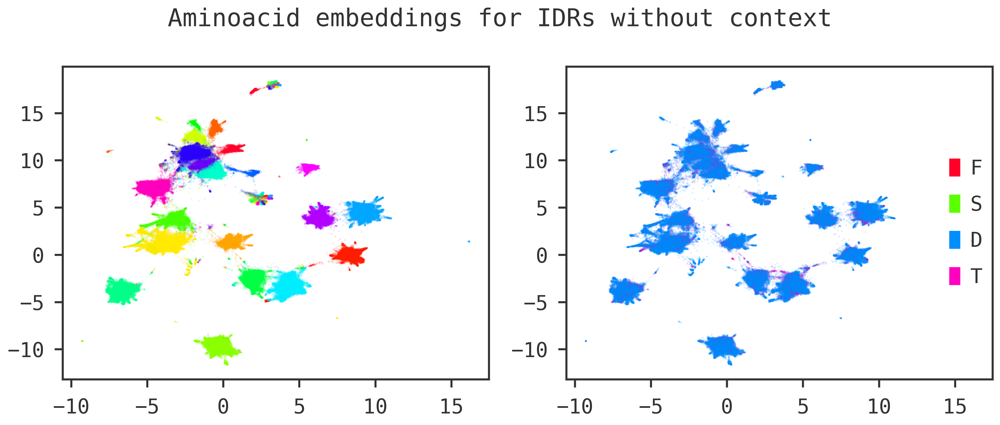

In [44]:
from matplotlib import cm
from matplotlib.patches import Patch

AAs = list(set(sequence_concat))
cmapAA = cm.get_cmap('gist_rainbow', len(AAs))
colordictAA = dict(zip(AAs, np.arange(0, len(AAs))))

fig = plt.figure(figsize=(14,6), dpi=300)
ax1  = fig.add_subplot(121)
ax2  = fig.add_subplot(122)

ax1.scatter(umap_embedding[:,0], umap_embedding[:,1], s=0.5, alpha=0.1, marker=',', c=[cmapAA(colordictAA[x]) for x in sequence_concat])

#legend_elements = [Patch(facecolor=cmapAA(colordictAA[x]), edgecolor=cmapAA(colordictAA[x]),label=x) for x in AAs]
#ax1.legend(handles=legend_elements, loc='right')

DDs = list(set(disorder_concat))
cmapDD = cm.get_cmap('gist_rainbow', len(DDs))
colordictDD = dict(zip(DDs, np.arange(0, len(DDs))))
ax2.scatter(umap_embedding[:,0], umap_embedding[:,1], s=0.5, alpha=0.1, marker=',', c=[cmapDD(colordictDD[x]) for x in disorder_concat])
legend_elements = [Patch(facecolor=cmapDD(colordictDD[x]), edgecolor=cmapDD(colordictDD[x]),label=x) for x in DDs]
ax2.legend(handles=legend_elements, loc='right')

fig.suptitle("Aminoacid embeddings for IDRs without context")
fig.tight_layout()
plt.show()

<ipython-input-11-fcfd31abdc9c>:10: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmapDD = cm.get_cmap('gist_rainbow', len(DDs))


S
D
T


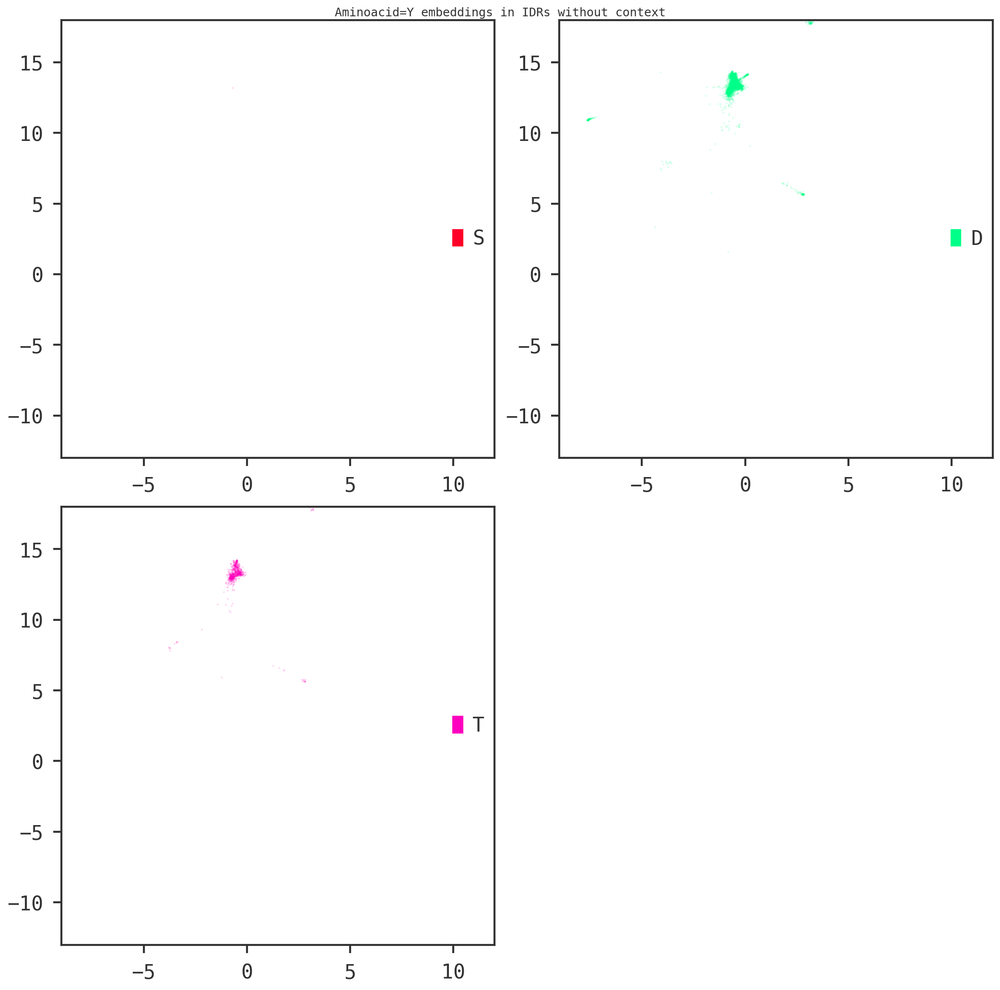

In [11]:
from matplotlib import cm
from matplotlib.patches import Patch

## select only a single aminoacid
aa_target = "Y"
indexes = np.array([i for i,aa in enumerate(sequence_concat) if aa == aa_target])
crop_umap_emb = umap_embedding[indexes,:]

DDs = list(set([disorder_concat[i] for i in indexes]))
cmapDD = cm.get_cmap('gist_rainbow', len(DDs))
colordictDD = dict(zip(DDs, np.arange(0, len(DDs))))

aa_disorder = [disorder_concat[i] for i in indexes]
fig = plt.figure(figsize=(14,14), dpi=150)
for i in range(len(DDs)):
    print(DDs[i])
    diso_index = np.array([k for k,dd in enumerate(aa_disorder) if dd == DDs[i]])
    ax = fig.add_subplot(2,2,i+1)
    ax.scatter(crop_umap_emb[diso_index,0], crop_umap_emb[diso_index,1], s=1, alpha=0.1, c=[cmapDD(colordictDD[x]) for x in [aa_disorder[j] for j in diso_index]])
    legend_elements = [Patch(facecolor=cmapDD(colordictDD[DDs[i]]), edgecolor=cmapDD(colordictDD[DDs[i]]),label=DDs[i])]
    ax.legend(handles=legend_elements, loc='right')
    ax.set_xlim(-9,12)
    ax.set_ylim(-13,18)

fig.suptitle(f"Aminoacid={aa_target} embeddings in IDRs without context")
fig.tight_layout()
plt.show()

In [145]:
# from the t5_embedding matrix, select only a single aminoacid type and re-do the UMAP embedding
aa_target = "A"
indexes = np.array([i for i,aa in enumerate(sequence_concat) if aa == aa_target])

embedding_matrix_target = embedding_matrix[indexes,:]
my_umap = umap.UMAP(n_neighbors=200, min_dist=.25) # metric='cosine'
umap_embedding_target = my_umap.fit_transform(embedding_matrix_target)


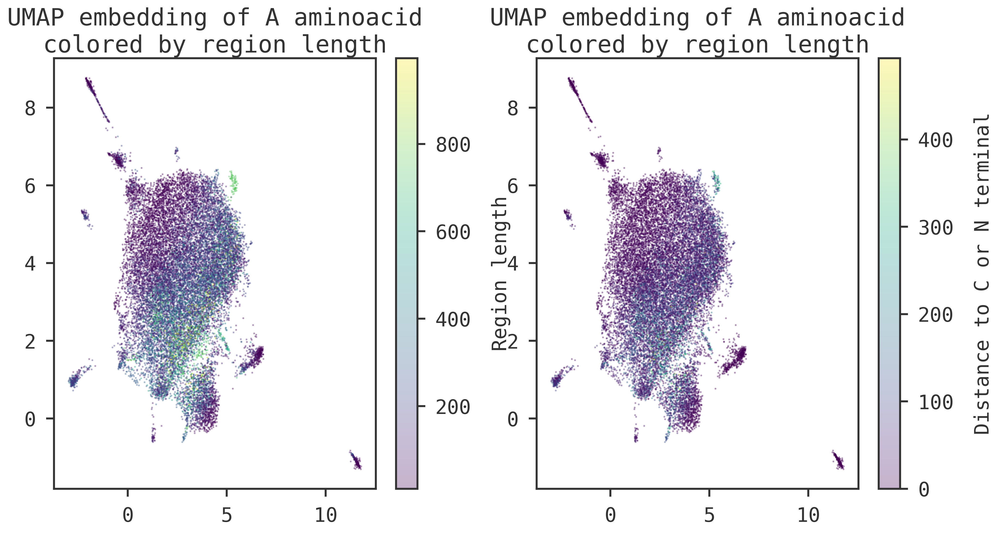

In [146]:
R_lengths = []
for r in concat_order:
    length = int(r[1])
    regions_ids.append(r[0])
    R_lengths.append(length)

# expand R_lengths
all_Rlengths = []
for l in R_lengths:
    all_Rlengths += [l for i in range(l)]

# use R_lengths to get distance to begining of end of the sequence
all_distRlengths = []
for l in R_lengths:
    for i in range(l):
        halfway_point = l/2
        if i < halfway_point:
            dist = i
        else:
            dist = l - i
        all_distRlengths += [dist]

target_Rlengths = [all_Rlengths[i] for i in indexes]
target_distRlengths = [all_distRlengths[i] for i in indexes]

# create umap plot
fig = plt.figure(figsize=(16,8), dpi=300)
ax1  = fig.add_subplot(121)
ax2  = fig.add_subplot(122)

c = ax1.scatter(umap_embedding_target[:,0], umap_embedding_target[:,1], s=1, alpha=0.3, marker='o', c=target_Rlengths)
cbar = fig.colorbar(c, ax=ax1)
cbar.set_label('Region length')
ax1.set_title(f"UMAP embedding of {aa_target} aminoacid\ncolored by region length")

c2 = ax2.scatter(umap_embedding_target[:,0], umap_embedding_target[:,1], s=1, alpha=0.3, marker='o', c=target_distRlengths)
cbar = fig.colorbar(c2, ax=ax2)
cbar.set_label('Distance to C or N terminal')
ax2.set_title(f"UMAP embedding of {aa_target} aminoacid\ncolored by region length")


plt.show()

In [147]:
R_lengths = []
regions_ids = []
for r in concat_order:
    length = int(r[1])
    regions_ids.append(r[0])
    R_lengths.append(length)

# expand region ids
all_region_ids = []
for i,r in enumerate(regions_ids):
    all_region_ids += [r for i in range(R_lengths[i])]

# expand R_lengths
all_Rlengths = []
for l in R_lengths:
    all_Rlengths += [l for i in range(l)]

# use R_lengths to get distance to begining of end of the sequence
all_distRlengths = []
for l in R_lengths:
    for i in range(l):
        halfway_point = l/2
        if i < halfway_point:
            dist = i
        else:
            dist = l - i
        all_distRlengths += [dist]


target_Rlengths = [all_Rlengths[i] for i in indexes]
target_distRlengths = [all_distRlengths[i] for i in indexes]
target_region_ids = [all_region_ids[i] for i in indexes]

# create umap plot using plotly
import plotly.express as px

df = pd.DataFrame(umap_embedding_target, columns=['x', 'y'])
df['Rlength'] = target_Rlengths
df['distRlength'] = target_distRlengths
df['aa'] = aa_target
df['region_id'] = target_region_ids
df['dummy_column_for_size'] = 1

#fig = px.scatter(df, x='x', y='y', color='Rlength', size='distRlength', hover_data=['region_id'])
fig = px.scatter(df, x='x', y='y', color='distRlength', hover_data=['region_id'], size='distRlength')
fig.update_layout(title=f"UMAP embedding of {aa_target} aminoacid, colored by distance to N/C-terminal")
fig.show()


In [84]:
# get protein-level embedding and stack them in a new matrix
acum = 0
lengths = []
protlevel_emb_matrix = None
regions_ids = []
for r in concat_order:
    length = int(r[1])
    regions_ids.append(r[0])
    lengths.append(length)
    protemb = np.mean(embedding_matrix[acum:acum+length], axis=0)
    if protlevel_emb_matrix is None:
        protlevel_emb_matrix = protemb
    else:
        protlevel_emb_matrix = np.vstack((protlevel_emb_matrix, protemb))

In [89]:
# plot umap embedding of the matrix

my_umap = umap.UMAP(n_neighbors=100, min_dist=.05) # metric='cosine'
protlevel_umap_emb = my_umap.fit_transform(protlevel_emb_matrix)

In [90]:
import plotly.express as px

df = pd.DataFrame(protlevel_umap_emb, columns=['x', 'y'])
df['regions'] = regions_ids
df['length'] = lengths

fig = px.scatter(df, x='x', y='y', color='length', hover_data=['regions'])
fig.show()

In [91]:
# Find the in-context regions on each embedding, make the same matrix as before, but with these in-context regions

disprot_regions_file = "/biodata/franco/datasets/disprot/DisProt_release_2023_12_with_ambiguous_evidences.tsv"
df = pd.read_table(disprot_regions_file, header=0)

# parse table into region ids and keep start and end
annot_dict = {}
for i, row in df.iterrows():
    region_id  = f"{row['acc']}_{row['region_id']}"
    if region_id not in annot_dict:
        annot_dict[region_id] = [row['start'], row['end']]

outcontext_matrix_embeddings = None
incontext_matrix_embeddings  = None
for unip_R in regions_ids:
    target, region_id = unip_R.split("_")
    #print(target, region_id)

    if 'seq' in disprot_dict[target]:
        seq  = disprot_dict[target]['seq']
        diso = disprot_dict[target]['disorder']
        embedding_file = os.path.join(embedding_dir, target + ".npy")
        #print(embedding_file)
        target_embedding = np.load(embedding_file)

        ## find target regions
        target_regions = [k for k in disprot_regions_dict if k == unip_R]
        assert len(target_regions) == 1
        ## need to load region embedding again, because some regions are from very long sequences not present in the other set of embeddings
        region_embedding_file = os.path.join(embedding_dir, unip_R+".npy")
        region_embedding = np.load(region_embedding_file)
        #print(region_embedding.shape)

        # get the target region in the embedding
        for t in target_regions:
            #print(t, annot_dict[t])
            start, end = annot_dict[t]
            assert disprot_regions_dict[t]['seq'] == disprot_dict[target]['seq'][start-1:end]
            if outcontext_matrix_embeddings is None:
                outcontext_matrix_embeddings = region_embedding
            else:
                outcontext_matrix_embeddings = np.vstack((outcontext_matrix_embeddings, region_embedding))
            if incontext_matrix_embeddings is None:
                incontext_matrix_embeddings = target_embedding[start-1:end]
            else:
                incontext_matrix_embeddings = np.vstack((incontext_matrix_embeddings, target_embedding[start-1:end]))


In [129]:
# save both matrices
# IDR region embeddings, calculated for the whole protein, then cut out from it
np.save("disprot_regions_incontext_embedding_matrix.npy", incontext_matrix_embeddings)
# IDR region embeddings, calculated from the regione sequence, without the 'ordered' sequence context
np.save("disprot_regions_outcontext_embedding_matrix.npy", outcontext_matrix_embeddings)

In [92]:
incontext_region_data = []
outcontext_sequence_concat = ""
for unip_R in regions_ids:
    target, region_id = unip_R.split("_")

    if 'seq' in disprot_dict[target]:
        seq  = disprot_dict[target]['seq']
        diso = disprot_dict[target]['disorder'] 
        ## find target regions
        target_regions = [k for k in disprot_regions_dict if k == unip_R]
        assert len(target_regions) == 1
        ## need to load region embedding again, because some regions are from very long sequences not present in the other set of embeddings
        # get the target region start and end
        for t in target_regions:
            start, end = annot_dict[t]
            assert disprot_regions_dict[t]['seq'] == disprot_dict[target]['seq'][start-1:end]
            outcontext_sequence_concat += disprot_dict[target]['seq'][start-1:end]
            incontext_region_data.append([unip_R, len(disprot_dict[target]['seq'][start-1:end])])


In [93]:
print(incontext_matrix_embeddings.shape)
print(outcontext_matrix_embeddings.shape)
print(len(outcontext_sequence_concat))

# ## select only a single aminoacid
# aa_target = "R"
# indexes = np.array([i for i,aa in enumerate(outcontext_sequence_concat) if aa == aa_target])

from scipy.spatial.distance import cosine

cos_distances = []
for i in range(incontext_matrix_embeddings.shape[0]):

    # Calculate cosine distance
    dist = cosine(incontext_matrix_embeddings[i,:], outcontext_matrix_embeddings[i,:])
    cos_distances.append(dist)
cos_distances = np.array(cos_distances)

(214077, 1024)
(214077, 1024)
214077


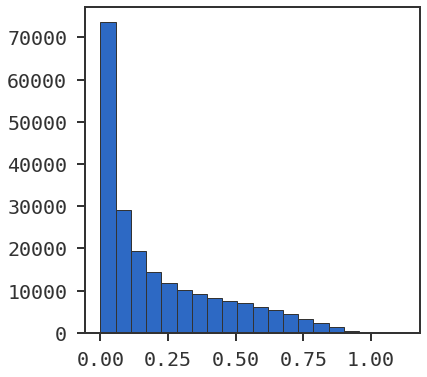

In [94]:
# make a histogram of the cos_distances
plt.figure(figsize=(6,6), dpi=72)
plt.hist(cos_distances)
plt.show()

In [173]:
# get the region from which the AA was taken, relative to region length
aa_reg_relativelen = []
for rid, length in incontext_region_data:
    aa_reg_relativelen += [float(i)/length for i in range(length)]
aa_reg_relativelen = np.array(aa_reg_relativelen)

# make a list with aminoacid type
aas = [aa for aa in outcontext_sequence_concat]

df = pd.DataFrame({'aa_reg_relativelen': aa_reg_relativelen, 'cos_distances': cos_distances, 'aa_reg_len': aa_reg_len, "AA":aas})

fig = px.scatter(df, x='aa_reg_relativelen', y='cos_distances', color='AA', size='aa_reg_len')
fig.show()

# %matplotlib inline
# plt.figure(figsize=(6,6), dpi=150)
# plt.scatter(aa_reg_relativelen, cos_distances, s=1, alpha=0.1)
# plt.show()